# Low Rank Decompositions of STFT Tensors
## Nicholas Richardson
### njericha@math.ubc.ca
## November 30, 2022

## Set up

In [50]:
# Dependencies
# Set to true on first run to ensure all packages are added
add_pkgs = false
if add_pkgs
    import Pkg
    Pkg.add("FFTW")
    Pkg.add("Plots")
    Pkg.add("WAV")
    Pkg.add("STFT")
    Pkg.add("TensorDecompositions")
    Pkg.add("Einsum")
end

Ensure you have downloaded the MUSEDB18 songs here: https://doi.org/10.5281/zenodo.3338373

In [51]:
# Change this to location of your MUSDB18 songs
folder = "..\\stems\\"

# Just the first 27 songs for faster runtime
songnames = ["A Classic Education - NightOwl", "Actions - One Minute Smile", "Angela Thomas Wade - Milk Cow Blues", "Atlantis Bound - It Was My Fault For Waiting", "Creepoid - OldTree", "Dreamers Of The Ghetto - Heavy Love", "Fergessen - The Wind", "Grants - PunchDrunk", "Hezekiah Jones - Borrowed Heart", "James May - All Souls Moon", "James May - On The Line", "Jokers, Jacks & Kings - Sea Of Leaves", "Leaf - Come Around", "Leaf - Wicked", "Meaxic - Take A Step", "Music Delta - Gospel", "Music Delta - Punk", "Night Panther - Fire", "Patrick Talbot - Set Me Free", "Port St Willow - Stay Even", "Remember December - C U Next Time", "Secret Mountains - High Horse", "Skelpolu - Together Alone", "The Districts - Vermont", "Traffic Experiment - Once More (With Feeling)", "Young Griffo - Facade", "Young Griffo - Pennies"]

instruments = [
    "bass",
    "drums",
    "mixture",
    "other",
    "vocals"
]

# For example, use filenames["bass"][1:3] to get the filenames for the first three bass tracks
filenames = Dict(
    (instruments[i],
     [folder * songnames[j] *"\\"* instruments[i] * ".wav" for j ∈ eachindex(songnames)]
     ) for i ∈ eachindex(instruments)
);

all_filenames = values(filenames)

ValueIterator for a Dict{String, Vector{String}} with 5 entries. Values:
  ["..\\stems\\A Classic Education - NightOwl\\bass.wav", "..\\stems\\Actions -…
  ["..\\stems\\A Classic Education - NightOwl\\other.wav", "..\\stems\\Actions …
  ["..\\stems\\A Classic Education - NightOwl\\drums.wav", "..\\stems\\Actions …
  ["..\\stems\\A Classic Education - NightOwl\\mixture.wav", "..\\stems\\Action…
  ["..\\stems\\A Classic Education - NightOwl\\vocals.wav", "..\\stems\\Actions…

In [52]:
# Optionaly preload all packages
use_pkgs = true
if use_pkgs
    using FFTW
    using Plots
    using WAV
    using STFT
    using TensorDecompositions
    using Einsum
end

# Overview
- Background
- Constructing an STFT Tensor
- Decomposing
- Reconstructing audio

Quick abstrct: use tensor decompositions to analyse musical instruments
What's to come:
- Background on DFT, STFT, NNCP
- Construct a tensor where each slice is a STFT
- Decompose it with NNCP
- Plot and *listen* to the result

# Background

## Working with song data
- 1D signal: $y:[0, T]\longrightarrow \mathbb{R}$

- Waveform Audio File (WAV) is a sampled signal $(y_1,\dots,y_N)\in\mathbb{R}^N$:
  $$
  y_n = y(t_{n})
  $$
where $t_{n}=\frac{n-1}{N-1}T$ are evenly spaced on $[0,T]$.

- Database: MUSDB18

Rafii, Zafar, Liutkus, Antoine, F.-R. Stöter, Mimilakis, Stylianos Ioannis, and Bittner, Rachel, ‘MUSDB18 - a corpus for music separation’. Zenodo, Dec. 17, 2017. doi: [10.5281/ZENODO.1117372](https://doi.org/10.5281/ZENODO.1117372)

### In Julia now!

In [53]:
songnames

27-element Vector{String}:
 "A Classic Education - NightOwl"
 "Actions - One Minute Smile"
 "Angela Thomas Wade - Milk Cow Blues"
 "Atlantis Bound - It Was My Fault For Waiting"
 "Creepoid - OldTree"
 "Dreamers Of The Ghetto - Heavy Love"
 "Fergessen - The Wind"
 "Grants - PunchDrunk"
 "Hezekiah Jones - Borrowed Heart"
 "James May - All Souls Moon"
 ⋮
 "Patrick Talbot - Set Me Free"
 "Port St Willow - Stay Even"
 "Remember December - C U Next Time"
 "Secret Mountains - High Horse"
 "Skelpolu - Together Alone"
 "The Districts - Vermont"
 "Traffic Experiment - Once More (With Feeling)"
 "Young Griffo - Facade"
 "Young Griffo - Pennies"

In [54]:
instruments

5-element Vector{String}:
 "bass"
 "drums"
 "mixture"
 "other"
 "vocals"

In [55]:
using WAV

# wrapper to import a song and generate time samples
function songread(filename::String)
    y, fs = wavread(filename)
    N = length(y)
    t = range(0, N/fs, length=N)
    return y, t, fs
end

songread (generic function with 1 method)

In [56]:
#read a song to get the sample rate
filename = filenames["drums"][1]
_, t, fs = songread(filename);

## The Short-Time Fourier Transform

- Like a "windowed" FFT

We have $\textbf{STFT}(y) = Y \in\mathbb{R}^{K,L}$
$$Y_{k,l} = \sum_{n=0}^{N-1} y_{n+1} w_{l-n-1} e^{-\frac{i2\pi}{N} kn} $$

### Hann window

- Smooth window function by Julius von Hann
- Less artifacts than the naive box 

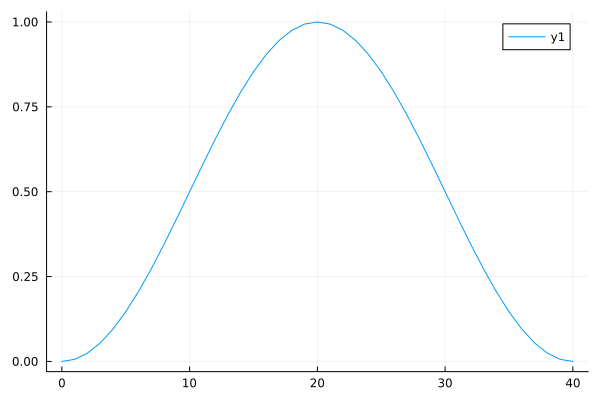

In [57]:
function hann(N::Int)
    N = N - N % 2 #makes sure N even
    n = 0:N
    return @. sin(π*n/N)^2
end

plot(0:40, hann(40))

In [58]:
w = 2^12 # window width
window = hann(w)
hop = w÷2 - 1 # number of samples to hop over

2047

wrapper to plot a STFT with time and frequency axies

In [59]:
# N = maximum frequency
# T = end of time interval
# t0 = start of time interval
function plotSTFT(Y, N, T, t0=0)
    nfreqs, ntimes = size(Y)
    freqs = range(0, N, nfreqs)
    times = range(t0, T, ntimes)

    Z = abs.(Y) .* (2/N)

    heatmap(times, freqs, Z)
end

plotSTFT (generic function with 2 methods)

## Non-negative Canonical Polyadic Decomposition (NNCP)

- Given $T\in \mathbb{R_{\geq 0}}^{n_1 \times n_2 \times n_3}$ and $r\in \mathbb{N}$

- Decompose into
$$T = \sum_{l=1}^r a^{(l)} \otimes b^{(l)} \otimes c^{(l)}$$

- where $a^{(l)}\in \mathbb{R}^{n_1}, b^{(l)}\in \mathbb{R}^{n_2}, c^{(l)}\in \mathbb{R}^{n_3}$

- write $A\in \mathbb{R_{\geq 0}}^{n_1 \times r}$ where $A_{il} = a_i^{(l)}$ and similarly for $B, C$

Write on board what this looks like \[|...|\]

- solve:

$$\min_{A,B,C} \frac{1}{2}\lVert T - A\circ B\circ C \rVert_F^2$$

$$= \min_{A,B,C} \frac{1}{2}\sum_{ijk} \left(T_{ijk} - \sum_{l}A_{il}B_{jl}C_{kl}\right)^2$$

$$= \min_{A,B,C} F(A,B,C)$$

$\lVert F(A_n,B_n,C_n) - F(A_{n-1},B_{n-1},C_{n-1})\rVert _F > \delta \lVert F(A_{n-1},B_{n-1},C_{n-1})\rVert _F$

$A_{n+1} = \max(0, A_n - \lambda_n^{(A)} \nabla_{A_n}F(A_n,B_n,C_n))$
$B_{n+1} = \max(0, B_n - \lambda_n^{(B)} \nabla_{B_n}F(A_{n+1},B_n,C_n))$
$C_{n+1} = \max(0, C_n - \lambda_n^{(C)} \nabla_{C_n}F(A_{n+1},B_{n+1},C_n))$

$$A_{n+1} = \argmin_A\ \langle \nabla_A F, A - \hat A_n \rangle + \frac{\lambda_n^{(A)}}{2} \lVert A - \hat A_n \rVert_F^2 $$
$$\hat A_n = A_n + \omega_n^{(A)}(A_n - A_{n-1})$$

some details are swept under the rug like what step size to use, adding momentum...

- while not converged
  - $$A_{n+1} = \arg\min_A\ \langle \nabla_A F, A - \hat A_n \rangle + \frac{\lambda_n^{(A)}}{2} \lVert A - \hat A_n \rVert_F^2$$

- while not converged
  - $$A_{n+1} = \max(0, \hat A_n - \nabla_{A}F/\lambda_n^{(A)})$$
  - $$B_{n+1} = \max(0, \hat B_n - \nabla_{B}F/\lambda_n^{(B)})$$
  - $$C_{n+1} = \max(0, \hat C_n - \nabla_{C}F/\lambda_n^{(C)})$$

- 
  - $\text{update}\ B_{n+1}$
  - $\text{update}\ C_{n+1}$

Here, $\hat A_n = A_n + \omega_n^{(A)}(A_n - A_{n-1})$


Y. Xu and W. Yin, ‘A Block Coordinate Descent Method for Regularized Multiconvex Optimization with Applications to Nonnegative Tensor Factorization and Completion’, _SIAM Journal on Imaging Sciences_, vol. 6, no. 3, pp. 1758–1789, 2013, doi: [10.1137/120887795](https://doi.org/10.1137/120887795).

inverse step size $$\lambda_n^{(A)} =\left\lVert(M^{(A)}_{n})^\top M^{(A)}_{n}\right\rVert_{2}$$ 

momentum $$\omega_n^{(A)}=\min\left( \frac{{t_{n-1}-1}}{t_{n}}, \frac{1}{2}\sqrt{\frac{\lambda_{n-1}^{(A)}}{\lambda_{n}^{(A)}}} \right)$$ 

$t_n = \frac{1}{2}\left(1+\sqrt{ 1+4t_{n}^2 }\right)$

We initialize $A,B,C$ with independent standard normal distributed entries, and $t_0=1$.

Gradients more verbosely at the $n^{\text{th}}$ iteration 
\begin{align}
\nabla_{A}F_{n}&=\nabla_{A}F(A_{n}, B_{n}, C_{n})\\
\nabla_{B}F_{n}&=\nabla_{B}F(A_{n+1}, B_{n}, C_{n}) \\
\nabla_{C}F_{n}&=\nabla_{C}F(A_{n+1}, B_{n+1}, C_{n}),
\end{align}
and the matrices $M$ defined as

\begin{align}
M_{n}^{(A)} &= B_{n}*C_{n}\\
M_{n}^{(B)} &= A_{n+1}*C_{n}\\
M_{n}^{(C)} &= A_{n+1}*B_{n+1}.
\end{align}

The $*$ is used to denote the Khatri-Rao product or the column-wise Kronecker product $A*B=[\text{Vec}(a^{(1)}\otimes b^{(1)}),\dots, \text{Vec}(a^{(r)}\otimes b^{(r)})]\in\mathbb{R}^{n_{1}n_{2}\times r}$ for the matricies $A\in\mathbb{R}^{n_{1}\times r}$ and $B\in\mathbb{R}^{n_{2}\times r}$.

# Let's make our tensor with all 27 songs!

- Take STFT of a bunch of song clips  

- Stack them into a 3-order tensor

- perform NNCP to find low-rank decomposition

- look at the results

- $T\in \mathbb{R}^{2049 \times 106 \times 27}$ (just under 6 million entries)

with low rank can compress this to 24 thousand, a factor of 244x reduction

In [60]:
songstart  = 10 # start from 10 second mark
songlength = 5  # keep 5 seconds
left  = songstart * fs
right = left + songlength * fs
slice = Int(left):Int(right);
t = t[slice];

In [61]:
# Given a real array, ensure the range of entries is between [-headroom, headroom] 
function normalize!(y::Array{T}) where {T <: Real}
    headroom = 0.95
    δ = 0.0001 # safe divide
    y .*= headroom / (maximum(abs.(y)) + δ)
end

normalize! (generic function with 1 method)

In [62]:
# Given a filename, import the audio and take the STFT
function songspectrogram(filename::String)
    y, fs = wavread(filename)
    y = y[slice]
    normalize!(y)
    Y = stft(y, window, hop)
    return Y
end

songspectrogram (generic function with 1 method)

## Finally Ready to Create our Tensor

In [63]:
instrument = "drums"
Ys = cat(map(songspectrogram, filenames[instrument])..., dims=3)
T = abs.(Ys) #just want magnitude
@show nfreqs, ntimes, nsongs = size(T)

(nfreqs, ntimes, nsongs) = size(T) = (2049, 106, 27)


(2049, 106, 27)

In [64]:
freqs = range(0   , fs/2  , nfreqs)
times = range(t[1], t[end], ntimes)
songs = 1:nsongs;

In [65]:
import Random
Random.seed!(314) # for repeatability
rank = 11 # one for each note SHOULD BE 12 BUT KEPT IT FOR CONSISTANCY
F = nncp(T, rank, tol=1e-3, compute_error=false, verbose=true);

NNCP iterations   2%|█                                  |  ETA: 0:00:12

NNCP iterations   4%|██                                 |  ETA: 0:00:10

NNCP iterations   6%|███                                |  ETA: 0:00:10

NNCP iterations   8%|███                                |  ETA: 0:00:10

NNCP iterations  10%|████                               |  ETA: 0:00:09

NNCP iterations  11%|████                               |  ETA: 0:00:10

NNCP iterations  12%|█████                              |  ETA: 0:00:10

NNCP iterations  13%|█████                              |  ETA: 0:00:09

NNCP iterations  14%|█████                              |  ETA: 0:00:09

NNCP iterations  16%|██████                             |  ETA: 0:00:09

NNCP iterations  18%|███████                            |  ETA: 0:00:09

NNCP iterations  19%|███████                            |  ETA: 0:00:09

NNCP iterations  21%|████████                           |  ETA: 0:00:08

NNCP iterations  22%|████████                           |  ETA: 0:00:09

NNCP iterations  24%|█████████                          |  ETA: 0:00:08

NNCP iterations  26%|██████████                         |  ETA: 0:00:08

NNCP iterations  27%|██████████                         |  ETA: 0:00:08

NNCP iterations  29%|███████████                        |  ETA: 0:00:08

NNCP iterations  30%|███████████                        |  ETA: 0:00:08

NNCP iterations  32%|████████████                       |  ETA: 0:00:07

NNCP iterations  34%|████████████                       |  ETA: 0:00:07

NNCP iterations  35%|█████████████                      |  ETA: 0:00:07

NNCP iterations  37%|█████████████                      |  ETA: 0:00:07

NNCP iterations  38%|██████████████                     |  ETA: 0:00:07

NNCP iterations  40%|███████████████                    |  ETA: 0:00:07

NNCP iterations  42%|███████████████                    |  ETA: 0:00:06

NNCP iterations  43%|████████████████                   |  ETA: 0:00:06

NNCP iterations  45%|████████████████                   |  ETA: 0:00:06

NNCP iterations  46%|█████████████████                  |  ETA: 0:00:06

NNCP iterations  48%|█████████████████                  |  ETA: 0:00:06

NNCP iterations  50%|██████████████████                 |  ETA: 0:00:05

NNCP iterations  51%|██████████████████                 |  ETA: 0:00:05

NNCP iterations 100%|███████████████████████████████████| Time: 0:00:05


┌ Info: Algorithm converged after 53 iterations.
└ @ TensorDecompositions C:\Users\Nicholas\.julia\packages\TensorDecompositions\3BVk2\src\utils.jl:233


In [66]:
A, B, C = F.factors;

In [67]:
# which low rank terms to plot
terms = 1:rank

# some plot settings
plt_size = (600, 1000)
layout = (rank, 1);

The "note" of each rank-1 term

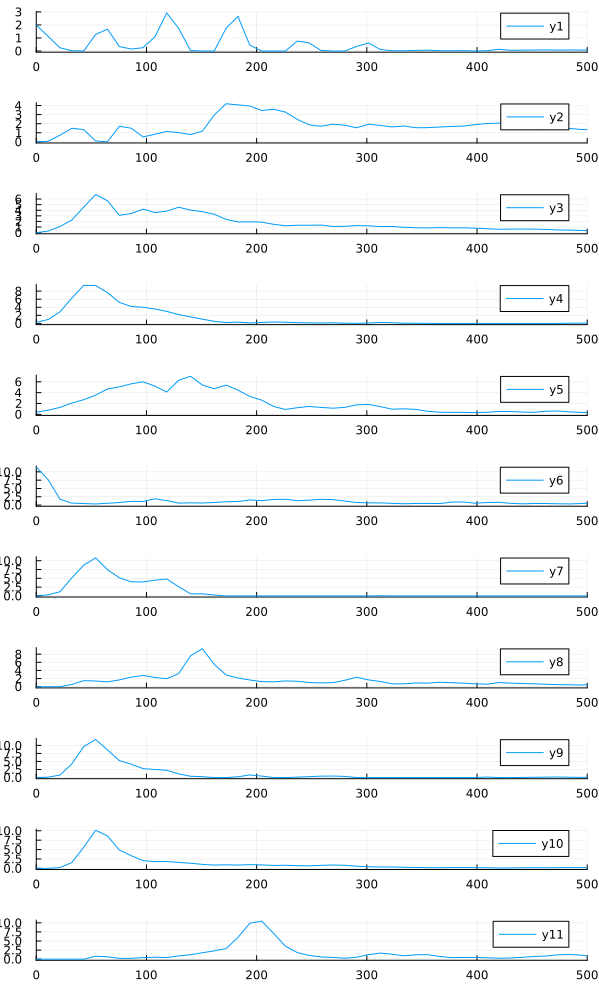

In [68]:
plot(freqs, A[:,terms], layout=layout)
plot!(xlims=(0,500), size = plt_size)

The rhythm of each rank-1 term

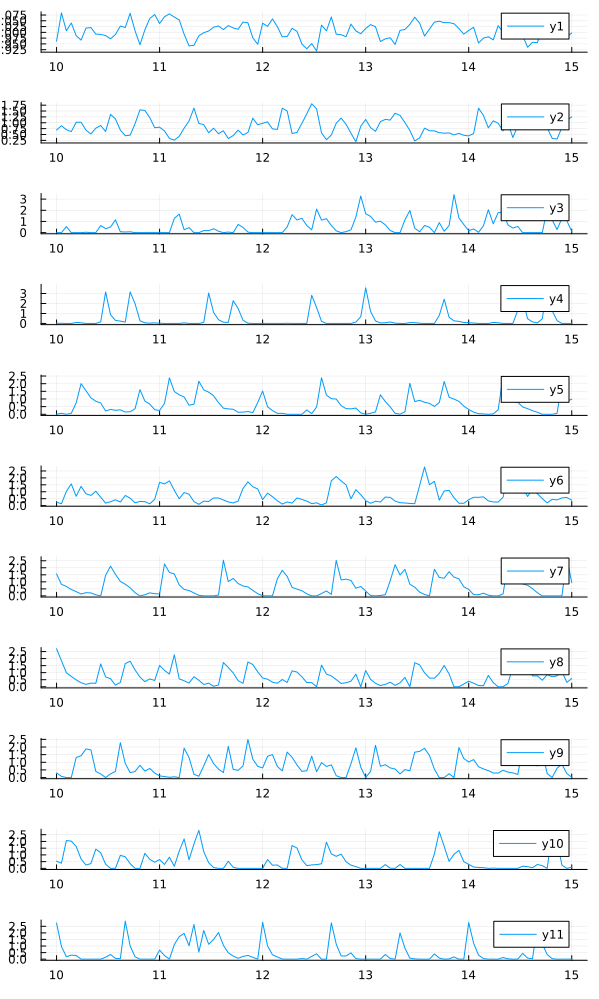

In [69]:
plot(times, B[:,terms], layout=layout)
plot!(size = plt_size)

Which songs use each note

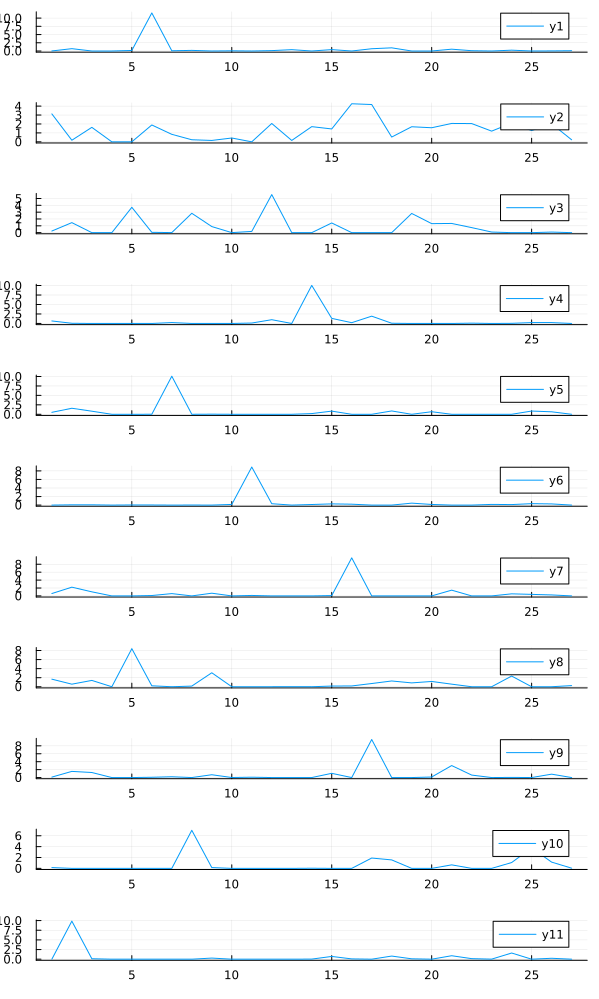

In [70]:
plot(songs, C[:,terms], layout=layout)
plot!(size = plt_size)

## Play the low rank terms

Build a STFT for each term, independent of the songs

In [71]:
@einsum R[i, j, l] := A[i, l] * B[j, l];

In [117]:
# which low rank term to look at in detail
term = 11;
song_number = 2;

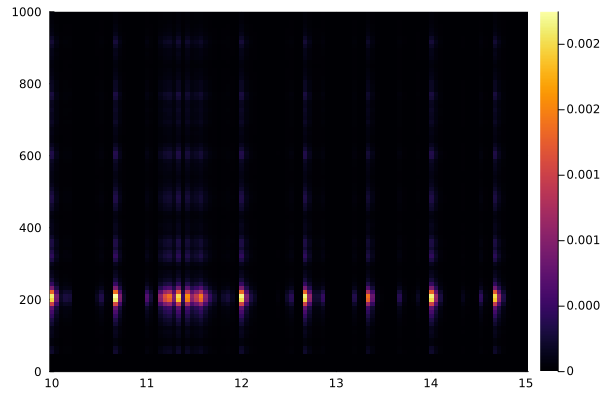

In [118]:
plotSTFT(R[:, :, term], fs/2, t[end], t[1])
plot!(ylims=(0,1000))

In [119]:
# add some complex phase
θ = angle.(Ys[:,:,song_number])
R1 = @. R[:,:,term] * ℯ^(im*θ);

In [120]:
# transform into time domain
r1 = istft(R1, window, hop)
r1 = r1[hop:end-hop]
normalize!(r1);

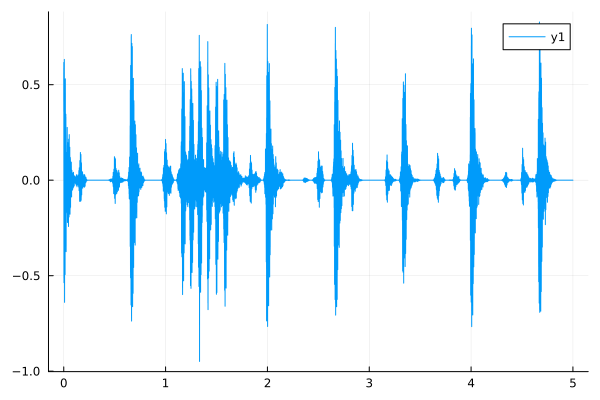

In [121]:
plot(range(0,5,length=length(r1)), r1)

In [122]:
wavplay(r1, fs)

That's the snare line!!

Repeat for another low rank term

In [78]:
term2 = 2
R2 = @. R[:,:,term2] * ℯ^(im*θ);

In [79]:
# transform into time domain
r2 = istft(R2, window, hop)
r2 = r2[hop:end-hop]
normalize!(r2);

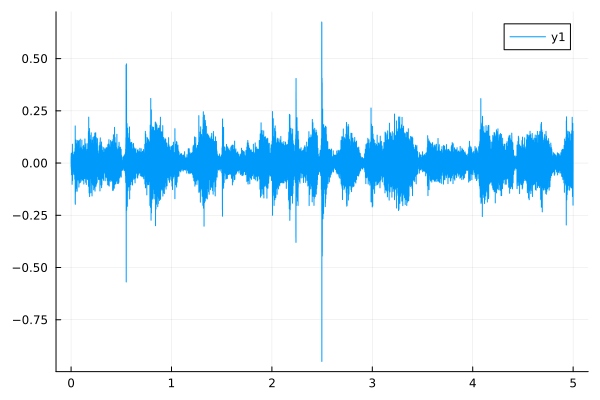

In [80]:
plot(range(0,5,length=length(r2)), r2)

In [81]:
wavplay(r2, fs)

This is the note "A" from the bass!

## Play recovered song

In [82]:
# Reconstructed low-rank tensor
@einsum S[i, j, k] := A[i, l] * B[j, l] * C[k, l];

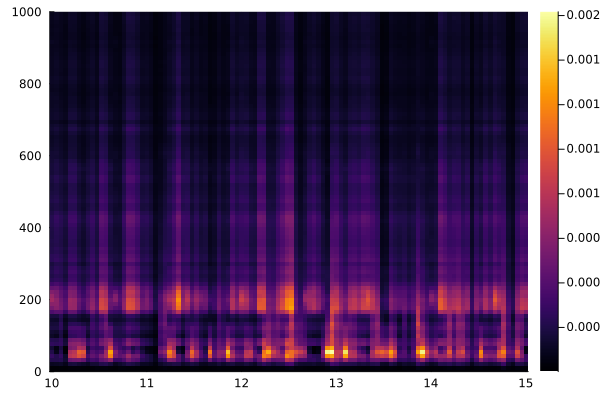

In [83]:
plotSTFT(S[:,:,song_number], fs/2, t[end], t[1])
plot!(ylims=(0,1000))

In [84]:
# Assume phase is same as original
θ = angle.(Ys)
Z = @. S * ℯ^(im*θ);

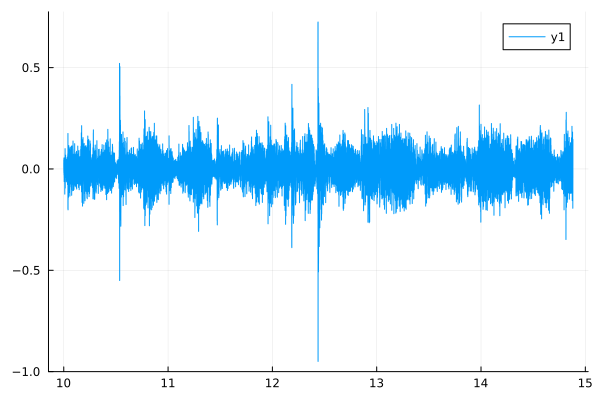

In [85]:
z = istft(Z[:,:,song_number], window, hop)
z = z[hop:end-hop]
normalize!(z)
plot(t[1:length(z)], z)

In [86]:
wavplay(z, fs)

Compare to original song

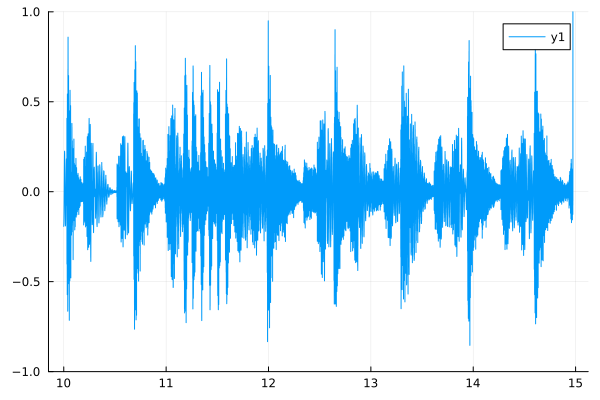

In [99]:
y = istft(Ys[:, :, song_number], window, hop)
plot(t[1:length(y)], y, ylims=(-1,1))

In [116]:
wavplay(y, fs) # original

In [89]:
wavplay(z, fs) # low-rank approximation

# Further Work
try:

- different instruments

- full songs (but not sure they are low-rank)

- use a log-magnitude scale when approximating T

- identify the musical notes it learned

- segment a full song into a stacked tensor

- each layer will be the same instrument playing
- so maybe it can learn the right frequencies better

# Summary

- constructed a tensor of STFTs of song clips

- used NNCP decomposition to find a low-rank approximation

- each term correspond to a pitch & rhythm played

- could see which songs used which notes

- listened to the recovered song

# Q & A
### njericha@math.ubc.ca